In [ ]:
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
from google.colab import drive
np.random.seed(200)
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/dataset_arya/Copy of arxiv_data.csv')

In [ ]:
df.head()

,titles,summaries,terms
0,Survey on Semantic Stereo Matching / Semantic ...,Stereo matching is one of the widely used tech...,"['cs.CV', 'cs.LG']"
1,FUTURE-AI: Guiding Principles and Consensus Re...,The recent advancements in artificial intellig...,"['cs.CV', 'cs.AI', 'cs.LG']"
2,Enforcing Mutual Consistency of Hard Regions f...,"In this paper, we proposed a novel mutual cons...","['cs.CV', 'cs.AI']"
3,Parameter Decoupling Strategy for Semi-supervi...,Consistency training has proven to be an advan...,['cs.CV']
4,Background-Foreground Segmentation for Interio...,"To ensure safety in automated driving, the cor...","['cs.CV', 'cs.LG']"


In [ ]:
df.iloc[1418]

titles       An information-theoretic derivation of min-cut...
summaries    Min-cut clustering, based on minimizing one of...
terms                                              ['stat.ML']
Name: 1418, dtype: object

In [ ]:
df.rename(columns = {"summaries" : "text", "terms" : "label"}, inplace = True)

In [ ]:
df.head()

,titles,text,label
0,Survey on Semantic Stereo Matching / Semantic ...,Stereo matching is one of the widely used tech...,"['cs.CV', 'cs.LG']"
1,FUTURE-AI: Guiding Principles and Consensus Re...,The recent advancements in artificial intellig...,"['cs.CV', 'cs.AI', 'cs.LG']"
2,Enforcing Mutual Consistency of Hard Regions f...,"In this paper, we proposed a novel mutual cons...","['cs.CV', 'cs.AI']"
3,Parameter Decoupling Strategy for Semi-supervi...,Consistency training has proven to be an advan...,['cs.CV']
4,Background-Foreground Segmentation for Interio...,"To ensure safety in automated driving, the cor...","['cs.CV', 'cs.LG']"


In [ ]:
def clean_text(text: str):
  text = text.lower()
  text = text.replace("\n", " ")
  text = re.sub('\W+',' ', text)
  text = " ".join(text.split())
  return text

In [ ]:
for x in range(df.shape[0]):
  df["text"][x] = str(df["titles"][x]) + str(df["text"][x])

In [ ]:
df.shape

(51774, 3)

In [ ]:
df["label"].value_counts()

['cs.CV']                                                            17369
['cs.LG', 'stat.ML']                                                  5251
['cs.LG']                                                             2732
['cs.CV', 'cs.LG']                                                    2067
['cs.LG', 'cs.AI']                                                    1702
                                                                     ...  
['cs.LG', 'stat.ML', 'I.6.4; I.5.3; I.4.6; I.2.4']                       1
['cs.LG', 'math.ST', 'stat.ML', 'stat.TH', '62H22, 62R01, 62J99']        1
['cs.LG', 'cs.RO', 'math.ST', 'stat.TH']                                 1
['cs.LG', 'cs.AI', 'cs.DS', '68T01, 68T09', 'I.2.6; I.5.1']              1
['stat.ML', 'cs.CV', 'cs.LG', 'q-bio.QM']                                1
Name: label, Length: 3157, dtype: int64

In [ ]:
df.head()

,titles,text,label
0,Survey on Semantic Stereo Matching / Semantic ...,Survey on Semantic Stereo Matching / Semantic ...,"['cs.CV', 'cs.LG']"
1,FUTURE-AI: Guiding Principles and Consensus Re...,FUTURE-AI: Guiding Principles and Consensus Re...,"['cs.CV', 'cs.AI', 'cs.LG']"
2,Enforcing Mutual Consistency of Hard Regions f...,Enforcing Mutual Consistency of Hard Regions f...,"['cs.CV', 'cs.AI']"
3,Parameter Decoupling Strategy for Semi-supervi...,Parameter Decoupling Strategy for Semi-supervi...,['cs.CV']
4,Background-Foreground Segmentation for Interio...,Background-Foreground Segmentation for Interio...,"['cs.CV', 'cs.LG']"


In [ ]:
df["text"] = df.text.apply(clean_text)

In [ ]:
df.head()

,titles,text,label
0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"['cs.CV', 'cs.LG']"
1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"['cs.CV', 'cs.AI', 'cs.LG']"
2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"['cs.CV', 'cs.AI']"
3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,['cs.CV']
4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"['cs.CV', 'cs.LG']"


In [ ]:
k = 0
dicti = {}
for index, row in df.iterrows():
  li = row['label'].strip("['").strip("']").split("', '")
  for i in li:
    if dicti.get(i) is None:
      dicti[i] = 1
    else:
      dicti[i] += 1

In [ ]:
dicti = dict(sorted(dicti.items(), key=lambda item: item[1], reverse=True))

In [ ]:
dicti['cs.CL']

1620

In [ ]:
df["token_counts"] = None

In [ ]:
for xi in range(df.shape[0]):
  df["token_counts"][xi] = len(df["text"][xi].split())

<AxesSubplot:>

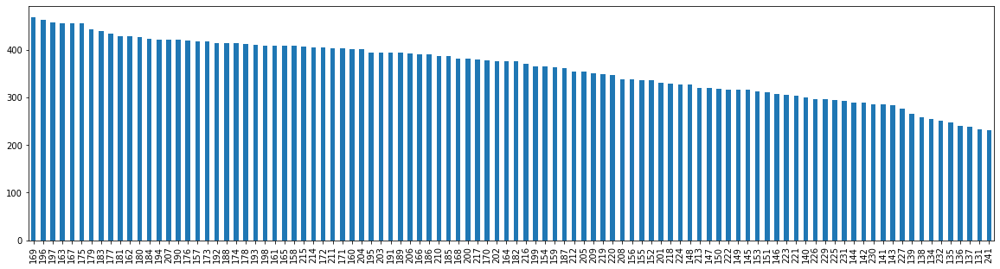

In [ ]:
plt.figure(figsize=(20,5))
df["token_counts"].value_counts().nlargest(100).plot(kind = 'bar')

In [ ]:
exp = {'q-bio.BM' : 'Biomolecules', 
 'q-bio.CB' : 'Cell Behavior',
 'q-bio.GN' : 'Genomics' , 
 'q-bio.MN' : 'Molecular Networks',
'q-bio.NC' : 'Neurons and Cognition', 
'q-bio.OT' : 'Other Quantitative Biology', 
'q-bio.PE' : 'Populations and Evolution', 
'q-bio.QM' : 'Quantitative Methods', 
'q-bio.SC' : 'Subcellular Processes', 
'q-bio.TO' : 'Tissues and Organs',
'cs.AI' : 'Artificial Intelligence', 
'cs.CL' : 'Computation and Language', 
'cs.CC' : 'Computational Complexity', 
'cs.CE' : 'Computational Engineering, Finance, and Science', 
'cs.CG' : 'Computational Geometry', 
'cs.GT' : 'Computer Science and Game Theory', 
'cs.CV' : 'Computer Vision and Pattern Recognition',
'cs.CY' : 'Computers and Society' ,
'cs.CR' : 'Cryptography and Security' ,
'cs.DS' : 'Data Structures and Algorithms' ,
'cs.DB' : 'Databases' ,
'cs.DL' : 'Digital Libraries' ,
'cs.DM' : 'Discrete Mathematics' ,
'cs.DC' : 'Distributed, Parallel, and Cluster Computing' ,
'cs.ET' : 'Emerging Technologies' ,
'cs.FL' : 'Formal Languages and Automata Theory' ,
'cs.GL' : 'General Literature' ,
'cs.GR' : 'Graphics' ,
'cs.AR' : 'Hardware Architecture' ,
'cs.HC' : 'Human-Computer Interaction' ,
'cs.IR' : 'Information Retrieval' ,
'cs.IT' : 'Information Theory' ,
'cs.LO' : 'Logic in Computer Science' ,
'cs.LG' : 'Machine Learning' ,
'cs.MS' : 'Mathematical Software' ,
'cs.MA' : 'Multiagent Systems' ,
'cs.MM' : 'Multimedia' ,
'cs.NI' : 'Networking and Internet Architecture' ,
'cs.NE' : 'Neural and Evolutionary Computing' ,
'cs.NA' : 'Numerical Analysis' ,
'cs.OS' : 'Operating Systems' ,
'cs.OH' : 'Other Computer Science' ,
'cs.PF' : 'Performance' ,
'cs.PL' : 'Programming Languages' ,
'cs.RO' : 'Robotics' ,
'cs.SI' : 'Social and Information Networks' ,
'cs.SE' : 'Software Engineering' ,
'cs.SD' : 'Sound',
'cs.SC' : 'Symbolic Computation',
'cs.SY' : 'Systems and Control',
'stat.AP' : 'Applications', 
'stat.CO' : 'Computation', 
'stat.ML' : 'Machine Learning', 
'stat.ME' : 'Methodology', 
'stat.OT' : 'Other Statistics', 
'stat.TH' : 'Statistics Theory',
'physics.acc-ph' : 'Accelerator Physics',
'physics.app-ph' : 'Applied Physics',
'physics.ao-ph' : 'Atmospheric and Oceanic Physics',
'physics.atom-ph' : 'Atomic Physics',
'physics.atm-clus' : 'Atomic and Molecular Clusters',
'physics.bio-ph' : 'Biological Physics',
'physics.chem-ph' : 'Chemical Physics',
'physics.class-ph' : 'Classical Physics',
'physics.comp-ph' : 'Computational Physics',
'physics.data-an' : 'Data Analysis, Statistics and Probability',
'physics.flu-dyn' : 'Fluid Dynamics',
'physics.gen-ph' : 'General Physics',
'physics.geo-ph' : 'Geophysics',
'physics.hist-ph' : 'History and Philosophy of Physics',
'physics.ins-det' : 'Instrumentation and Detectors',
'physics.med-ph' : 'Medical Physics',
'physics.optics' : 'Optics',
'physics.ed-ph' : 'Physics Education',
'physics.soc-ph' : 'Physics and Society',
'physics.plasm-ph' : 'Plasma Physics',
'physics.pop-ph' : 'Popular Physics',
'physics.space-ph' : 'Space Physics',
'math.AG' : 'Algebraic Geometry',
'math.AT' : 'Algebraic Topology',
'math.AP' : 'Analysis of PDEs',
'math.CT' : 'Category Theory',
'math.CA' : 'Classical Analysis and ODEs',
'math.CO' : 'Combinatorics',
'math.AC' : 'Commutative Algebra',
'math.CV' : 'Complex Variables',
'math.DG' : 'Differential Geometry',
'math.DS' : 'Dynamical Systems',
'math.FA' : 'Functional Analysis',
'math.GM' : 'General Mathematics',
'math.GN' : 'General Topology',
'math.GT' : 'Geometric Topology',
'math.GR' : 'Group Theory',
'math.HO' : 'History and Overview',
'math.IT' : 'Information Theory',
'math.KT' : 'K-Theory and Homology',
'math.LO' : 'Logic',
'math.MP' : 'Mathematical Physics',
'math.MG' : 'Metric Geometry',
'math.NT' : 'Number Theory',
'math.OA' : 'Operator Algebras',
'math.OC' : 'Optimization and Control',
'math.PR' : 'Probability',
'math.QA' : 'Quantum Algebra',
'math.RT' : 'Representation Theory',
'math.RA' : 'Rings and Algebras',
'math.SP' : 'Spectral Theory',
'math.ST' : 'Statistics Theory',
'math.SG' : 'Symplectic Geometry',
'math.NA' : 'Numerical Analysis'
}

In [ ]:
special = ['Machine Learning', 'Computer Vision and Pattern Recognition', 'Databases', 'Computation and Language', 'Algebraic Geometry', 'Numerical Analysis']

In [ ]:
for i in exp.keys():
  if exp[i] not in special:
    exp[i] = 'Other'

NameError: ignored

In [ ]:
exp

{'q-bio.BM': 'Other',
 'q-bio.CB': 'Other',
 'eess.IV': 'Image and Video Processing',
 'q-bio.GN': 'Other',
 'q-bio.MN': 'Other',
 'q-bio.NC': 'Other',
 'q-bio.OT': 'Other',
 'q-bio.PE': 'Other',
 'q-bio.QM': 'Other',
 'q-bio.SC': 'Other',
 'q-bio.TO': 'Other',
 'cs.AI': 'Artificial Intelligence',
 'cs.CL': 'Computation and Language',
 'cs.CC': 'Other',
 'cs.CE': 'Other',
 'cs.CG': 'Other',
 'cs.GT': 'Other',
 'cs.CV': 'Computer Vision and Pattern Recognition',
 'cs.CY': 'Other',
 'cs.CR': 'Other',
 'cs.DS': 'Other',
 'cs.DB': 'Other',
 'cs.DL': 'Other',
 'cs.DM': 'Other',
 'cs.DC': 'Other',
 'cs.ET': 'Other',
 'cs.FL': 'Other',
 'cs.GL': 'Other',
 'cs.GR': 'Other',
 'cs.AR': 'Other',
 'cs.HC': 'Other',
 'cs.IR': 'Other',
 'cs.IT': 'Other',
 'cs.LO': 'Other',
 'cs.LG': 'Machine Learning',
 'cs.MS': 'Other',
 'cs.MA': 'Other',
 'cs.MM': 'Other',
 'cs.NI': 'Other',
 'cs.NE': 'Other',
 'cs.NA': 'Other',
 'cs.OS': 'Other',
 'cs.OH': 'Other',
 'cs.PF': 'Other',
 'cs.PL': 'Other',
 'cs.RO': 

In [ ]:
df.head()

,titles,text,label,token_counts
0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"['cs.CV', 'cs.LG']",141
1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"['cs.CV', 'cs.AI', 'cs.LG']",225
2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"['cs.CV', 'cs.AI']",259
3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,['cs.CV'],218
4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"['cs.CV', 'cs.LG']",291


In [ ]:
df["label"][0][0]

'['

In [ ]:
df.head(1)

,titles,text,label,token_counts
0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"['cs.CV', 'cs.LG']",141


In [ ]:
import ast

In [ ]:
for x in range(df.shape[0]):
  df["label"][x] =  ast.literal_eval(df["label"][x])

In [ ]:
df["label"][0]

['cs.CV', 'cs.LG']

In [ ]:
labels_list = list(exp.keys())

In [ ]:
df.columns

Index(['titles', 'text', 'label', 'token_counts'], dtype='object')

In [ ]:
np.average(df.token_counts.values)

189.29221230733572

In [ ]:
drop_index = []

In [ ]:
for x in range(df.shape[0]):
  labels = df["label"][x]
  for y in range(len(labels)):
    if labels[y] in exp:
      labels[y] = exp[labels[y]]
    else:
      drop_index.append(x)

In [ ]:
df_temp = df.drop(drop_index)

In [ ]:
df_temp.shape

(45993, 4)

In [ ]:
df.shape, df_temp.shape

((51774, 4), (45993, 4))

In [ ]:
df_temp.head()

,titles,text,label,token_counts
0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141
1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Arti...",225
2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Arti...",259
3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218
4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291


In [ ]:
df_temp.reset_index(inplace = True)

In [ ]:
df_temp.head()

,index,titles,text,label,token_counts
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141
1,1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Othe...",225
2,2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Other]",259
3,3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218
4,4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291


In [ ]:
df.head()

,titles,text,label,token_counts
0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141
1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Arti...",225
2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Arti...",259
3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218
4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291


In [ ]:
# df_temp.to_csv("archive_clean.csv", index = False)

In [ ]:
df = df_temp

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
from sklearn.preprocessing import MultiLabelBinarizer

In [ ]:
mlb = MultiLabelBinarizer()

In [ ]:
mlb.fit(df["label"])

MultiLabelBinarizer()

In [ ]:
# binary_label.head()

In [ ]:
mlb.classes_

array(['Algebraic Geometry', 'Algebraic Topology', 'Analysis of PDEs',
       'Applications', 'Applied Physics', 'Artificial Intelligence',
       'Atmospheric and Oceanic Physics', 'Biological Physics',
       'Biomolecules', 'Category Theory', 'Cell Behavior',
       'Chemical Physics', 'Classical Analysis and ODEs',
       'Classical Physics', 'Combinatorics', 'Commutative Algebra',
       'Complex Variables', 'Computation', 'Computation and Language',
       'Computational Complexity',
       'Computational Engineering, Finance, and Science',
       'Computational Geometry', 'Computational Physics',
       'Computer Science and Game Theory',
       'Computer Vision and Pattern Recognition', 'Computers and Society',
       'Cryptography and Security',
       'Data Analysis, Statistics and Probability',
       'Data Structures and Algorithms', 'Databases',
       'Differential Geometry', 'Digital Libraries',
       'Discrete Mathematics',
       'Distributed, Parallel, and Cluster Co

In [ ]:
class_list = list(mlb.classes_)

In [ ]:
len(class_list)

88

In [ ]:
for x in class_list:
  class_name = x
  df[class_name] = np.zeros((len(df),1))

In [ ]:
df.shape

(45993, 93)

In [ ]:
df.head(1)

,index,titles,text,label,token_counts,Algebraic Geometry,Algebraic Topology,Analysis of PDEs,Applications,Applied Physics,...,Rings and Algebras,Robotics,Social and Information Networks,Software Engineering,Sound,Spectral Theory,Statistics Theory,Symbolic Computation,Systems and Control,Tissues and Organs
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
for x in range(df.shape[0]):
  labels = df["label"][x]
  for y in labels:
    df[y][x] = 1

<ipython-input-31-7667c5da12f9>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[y][x] = 1


In [ ]:
df.head()

,index,titles,text,label,token_counts,Algebraic Geometry,Computation and Language,Computer Vision and Pattern Recognition,Databases,Machine Learning,Numerical Analysis,Other
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Othe...",225,0.0,0.0,1.0,0.0,1.0,0.0,1.0
2,2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Other]",259,0.0,0.0,1.0,0.0,0.0,0.0,1.0
3,3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291,0.0,0.0,1.0,0.0,1.0,0.0,0.0


## Doc2Vec 

## BERT 

In [ ]:
train_s, test_s = train_test_split(df, test_size = 0.3, shuffle = True)

In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 51.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.3/190.3 KB 24.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 105.8 MB/s eta 0:00:00


In [ ]:
import transformers
import torch
from torch.utils.data import Dataset, DataLoader, RandomSampler, SequentialSampler
from transformers import BertTokenizer, AutoTokenizer, BertModel, BertConfig, AutoModel, AdamW
import warnings
warnings.filterwarnings('ignore')

In [ ]:
MAX_LEN = 256
TRAIN_BATCH_SIZE = 16
VALID_BATCH_SIZE = 16
EPOCHS = 4
LEARNING_RATE = 1e-05
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
device

'cuda'

In [ ]:
df[class_list].values

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
class BERTDataset(Dataset):
    def __init__(self, df, tokenizer, max_len):
        self.df = df
        self.max_len = max_len
        self.text = df.text
        self.tokenizer = tokenizer
        self.targets = df[class_list].values
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, index):
        text = self.text[index]
        inputs = self.tokenizer.encode_plus(
            text,
            truncation=True,
            add_special_tokens=True,
            max_length=self.max_len,
            padding='max_length',
            return_token_type_ids=True
        )
        ids = inputs['input_ids']
        mask = inputs['attention_mask']
        token_type_ids = inputs["token_type_ids"]
        
        return {
            'ids': torch.tensor(ids, dtype=torch.long),
            'mask': torch.tensor(mask, dtype=torch.long),
            'token_type_ids': torch.tensor(token_type_ids, dtype=torch.long),
            'targets': torch.tensor(self.targets[index], dtype=torch.float)
        }

In [ ]:
train, valid = train_test_split(train_s, test_size = 0.1, shuffle = True, random_state = 42)

In [ ]:
train.shape, valid.shape

((28975, 93), (3220, 93))

In [ ]:
df_train = train
df_dev = valid

In [ ]:
print(df.shape)
print(train_s.shape)
print(test_s.shape) # for testing
print(train.shape) 
print(valid.shape)

(45993, 93)
(32195, 93)
(13798, 93)
(28975, 93)
(3220, 93)


In [ ]:
df_train.reset_index(inplace = True)
df_dev.reset_index(inplace = True)

In [ ]:
valid_dataset.__getitem__(1)

{'ids': tensor([  101,  1042, 20952,  2102,  7159,  5307,  2125,  8275,  4871,  2478,
          8275, 10788,  2986, 17372,  2897, 16748,  5844,  8275,  4871,  1998,
          6876,  2107,  2004,  2784,  7011,  3489,  2038,  2468,  2172,  6082,
          2122,  2420,  2349,  2000,  1996, 12607,  1999, 11416,  6024,  4748,
         14028, 10980,  2140,  6125, 25957,  2015,  9308,  3522,  2470,  2107,
          2004,  1996,  2261,  2915,  4083,  2064,  3443,  3811, 12689,  3167,
          3550,  8275,  4871,  2007,  2069,  1037,  2261,  4871,  3568,  1996,
          5081,  1997,  2784,  7011,  3489,  2000,  2022,  2109,  2005,  1037,
          3528,  1997, 24391,  7848,  2015,  2107,  2004, 17678, 16098,  3436,
          8275,  4871,  1998,  6876,  4150, 15157,  1998, 25952,  2122,  3698,
          7013,  8275,  4871,  2038,  2042,  3243, 10368,  2084,  2412,  1999,
          2023,  2147,  2057, 16599,  1037,  2422,  3635, 15873,  2986, 17372,
         15756,  2897,  2241,  2465, 18095,  

In [ ]:
train_dataset = BERTDataset(df_train, tokenizer, MAX_LEN)
valid_dataset = BERTDataset(df_dev, tokenizer, MAX_LEN)

In [ ]:
train_loader = DataLoader(train_dataset, batch_size=TRAIN_BATCH_SIZE, 
                          num_workers=4, shuffle=True, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=VALID_BATCH_SIZE, 
                          num_workers=4, shuffle=False, pin_memory=True)

In [ ]:
len(train_loader), len(valid_loader)

(1811, 202)

In [ ]:
torch.cuda.empty_cache()

In [ ]:
# Creating the customized model, by adding a drop out and a dense layer on top of distil
# bert to get the final output for the model. 

def load_ckp(checkpoint_fpath, model, optimizer):
    """
    checkpoint_path: path to save checkpoint
    model: model that we want to load checkpoint parameters into       
    optimizer: optimizer we defined in previous training
    """
    # load check point
    checkpoint = torch.load(checkpoint_fpath)
    # initialize state_dict from checkpoint to model
    model.load_state_dict(checkpoint['state_dict'])
    # initialize optimizer from checkpoint to optimizer
    optimizer.load_state_dict(checkpoint['optimizer'])
    # initialize valid_loss_min from checkpoint to valid_loss_min
    valid_loss_min = checkpoint['valid_loss_min']
    # return model, optimizer, epoch value, min validation loss 
    return model, optimizer, checkpoint['epoch'], valid_loss_min.item()

In [ ]:
class BERTClass(torch.nn.Module):
    def __init__(self):
        super(BERTClass, self).__init__()
        self.l1 = transformers.BertModel.from_pretrained('bert-base-uncased', return_dict=False)
        self.l2 = torch.nn.Dropout(0.3)
        self.l3 = torch.nn.Linear(768, len(class_list))
    
    def forward(self, ids, mask, token_type_ids):
        _, output_1= self.l1(ids, attention_mask = mask, token_type_ids = token_type_ids)
        output_2 = self.l2(output_1)
        output = self.l3(output_2)
        return output

model = BERTClass()
model.to(device)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.seq_relationship.weight', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


BERTClass(
  (l1): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    

In [ ]:
def loss_fn(outputs, targets):
    return torch.nn.BCEWithLogitsLoss()(outputs, targets)

In [ ]:
optimizer = AdamW(params =  model.parameters(), lr=LEARNING_RATE, weight_decay=1e-6)

In [ ]:
def load_ckp(checkpoint_fpath, model, optimizer):
    """
    checkpoint_path: path to save checkpoint
    model: model that we want to load checkpoint parameters into       
    optimizer: optimizer we defined in previous training
    """
    # load check point
    checkpoint = torch.load(checkpoint_fpath)
    # initialize state_dict from checkpoint to model
    model.load_state_dict(checkpoint['state_dict'])
    # initialize optimizer from checkpoint to optimizer
    optimizer.load_state_dict(checkpoint['optimizer'])
    # initialize valid_loss_min from checkpoint to valid_loss_min
    valid_loss_min = checkpoint['valid_loss_min']
    # return model, optimizer, epoch value, min validation loss 
    return model, optimizer, checkpoint['epoch'], valid_loss_min.item()

In [ ]:
import shutil, sys   
def save_ckp(state, is_best, checkpoint_path, best_model_path):
    """
    state: checkpoint we want to save
    is_best: is this the best checkpoint; min validation loss
    checkpoint_path: path to save checkpoint
    best_model_path: path to save best model
    """
    f_path = checkpoint_path
    # save checkpoint data to the path given, checkpoint_path
    torch.save(state, f_path)
    # if it is a best model, min validation loss
    if is_best:
        best_fpath = best_model_path
        # copy that checkpoint file to best path given, best_model_path
        shutil.copyfile(f_path, best_fpath)

In [ ]:
#to use as global variables
val_targets=[]
val_outputs=[] 

In [ ]:
def train_model(start_epochs,  n_epochs, valid_loss_min_input, 
                training_loader, validation_loader, model, 
                optimizer, checkpoint_path, best_model_path):
   
  # initialize tracker for minimum validation loss
  valid_loss_min = valid_loss_min_input 
   
 
  for epoch in range(start_epochs, n_epochs+1):
    train_loss = 0
    valid_loss = 0

    model.train()
    print('############# Epoch {}: Training Start   #############'.format(epoch))
    for batch_idx, data in enumerate(training_loader):
        #print('yyy epoch', batch_idx)
        ids = data['ids'].to(device, dtype = torch.long)
        mask = data['mask'].to(device, dtype = torch.long)
        token_type_ids = data['token_type_ids'].to(device, dtype = torch.long)
        targets = data['targets'].to(device, dtype = torch.float)

        outputs = model(ids, mask, token_type_ids)

        optimizer.zero_grad()
        loss = loss_fn(outputs, targets)
        #if batch_idx%5000==0:
         #   print(f'Epoch: {epoch}, Training Loss:  {loss.item()}')
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        #print('before loss data in training', loss.item(), train_loss)
        train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.item() - train_loss))
        #print('after loss data in training', loss.item(), train_loss)
    
    print('############# Epoch {}: Training End     #############'.format(epoch))
    
    print('############# Epoch {}: Validation Start   #############'.format(epoch))
    ######################    
    # validate the model #
    ######################
 
    model.eval()
   
    with torch.no_grad():
      for batch_idx, data in enumerate(validation_loader, 0):
            ids = data['ids'].to(device, dtype = torch.long)
            mask = data['mask'].to(device, dtype = torch.long)
            token_type_ids = data['token_type_ids'].to(device, dtype = torch.long)
            targets = data['targets'].to(device, dtype = torch.float)
            outputs = model(ids, mask, token_type_ids)

            loss = loss_fn(outputs, targets)
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (loss.item() - valid_loss))
            val_targets.extend(targets.cpu().detach().numpy().tolist())
            val_outputs.extend(torch.sigmoid(outputs).cpu().detach().numpy().tolist())

      print('############# Epoch {}: Validation End     #############'.format(epoch))
      # calculate average losses
      #print('before cal avg train loss', train_loss)
      train_loss = train_loss/len(training_loader)
      valid_loss = valid_loss/len(validation_loader)
      # print training/validation statistics 
      print('Epoch: {} \tAvgerage Training Loss: {:.6f} \tAverage Validation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
      
      # create checkpoint variable and add important data
      checkpoint = {
            'epoch': epoch + 1,
            'valid_loss_min': valid_loss,
            'state_dict': model.state_dict(),
            'optimizer': optimizer.state_dict()
      }
        
        # save checkpoint
      save_ckp(checkpoint, False, checkpoint_path, best_model_path)
        
      ## TODO: save the model if validation loss has decreased
      if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(valid_loss_min,valid_loss))
        # save checkpoint as best model
        save_ckp(checkpoint, True, checkpoint_path, best_model_path)
        valid_loss_min = valid_loss

    print('############# Epoch {}  Done   #############\n'.format(epoch))


  return model

In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 575.9/575.9 KB 11.3 MB/s eta 0:00:00


In [ ]:
import shap

# print the JS visualization code to the notebook
shap.initjs()

In [ ]:
def make_predictions(validation_loader1):
    for batch_idx, data in enumerate(validation_loader1, 0):
        ids = data['ids'].to(device, dtype = torch.long)
        mask = data['mask'].to(device, dtype = torch.long)
        token_type_ids = data['token_type_ids'].to(device, dtype = torch.long)
        targets = data['targets'].to(device, dtype = torch.float)
        outputs = model(ids, mask, token_type_ids)

#masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(make_predictions, output_names=mlb.classes_)


In [ ]:
valid_dataset1 = BERTDataset(df_dev[1:3], tokenizer, MAX_LEN)
valid_loader1 = DataLoader(valid_dataset1, batch_size=VALID_BATCH_SIZE, 
                          num_workers=4, shuffle=False, pin_memory=True)

shap_values = explainer(X_batch_text)
X_batch = xval_tfidf[1:3]
preds_proba = classifier.predict(X_batch)
preds = preds_proba.argmax(axis=1)

shap.waterfall_plot(shap_values[0][:, mlb.classes_[preds[0]]], max_display=15)

In [ ]:
checkpoint_path = '/content/Multi_Class_Classificationcurrent_checkpoint.pt'
best_model = '/content/Multi_Class_Classification_best_model.pt'
trained_model = train_model(1, 5, np.Inf, train_loader, valid_loader, model, 
                      optimizer,
                      checkpoint_path,
                      best_model)

############# Epoch 1: Training Start   #############
############# Epoch 1: Training End     #############
############# Epoch 1: Validation Start   #############
############# Epoch 1: Validation End     #############
Epoch: 1 	Avgerage Training Loss: 0.000054 	Average Validation Loss: 0.000163
Validation loss decreased (inf --> 0.000163).  Saving model ...
############# Epoch 1  Done   #############

############# Epoch 2: Training Start   #############
############# Epoch 2: Training End     #############
############# Epoch 2: Validation Start   #############
############# Epoch 2: Validation End     #############
Epoch: 2 	Avgerage Training Loss: 0.000016 	Average Validation Loss: 0.000134
Validation loss decreased (0.000163 --> 0.000134).  Saving model ...
############# Epoch 2  Done   #############

############# Epoch 3: Training Start   #############
############# Epoch 3: Training End     #############
############# Epoch 3: Validation Start   #############
############# Epo

In [ ]:
val_preds = (np.array(val_outputs) > 0.5).astype(int)
val_preds

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
from sklearn import metrics

In [ ]:
accuracy = metrics.accuracy_score(val_targets, val_preds)
f1_score_micro = metrics.f1_score(val_targets, val_preds, average='micro')
f1_score_macro = metrics.f1_score(val_targets, val_preds, average='macro')
print(f"Accuracy Score = {accuracy}")
print(f"F1 Score (Micro) = {f1_score_micro}")
print(f"F1 Score (Macro) = {f1_score_macro}")

Accuracy Score = 0.5652173913043478
F1 Score (Micro) = 0.7756312924852251
F1 Score (Macro) = 0.023747331583452127


In [ ]:
from sklearn.metrics import multilabel_confusion_matrix as mcm, classification_report

In [ ]:
cm_labels = class_list
    
cm = mcm(val_targets, val_preds)

In [ ]:
print(classification_report(val_targets, val_preds))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00        15
           2       0.00      0.00      0.00         5
           3       0.00      0.00      0.00       105
           4       0.00      0.00      0.00         5
           5       0.57      0.07      0.13      2345
           6       0.00      0.00      0.00         5
           7       0.00      0.00      0.00         5
           8       0.00      0.00      0.00        20
           9       0.00      0.00      0.00         0
          10       0.00      0.00      0.00         0
          11       0.00      0.00      0.00        20
          12       0.00      0.00      0.00        10
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         5
          15       0.00      0.00      0.00         0
          16       0.00      0.00      0.00         0
          17       0.00    

In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns


def print_confusion_matrix(confusion_matrix, axes, class_label, class_names, fontsize=14):

    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names,
    )

    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d", cbar=False, ax=axes)
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    axes.set_xlabel('True label')
    axes.set_ylabel('Predicted label')
    axes.set_title("Confusion Matrix for the class - " + class_label)

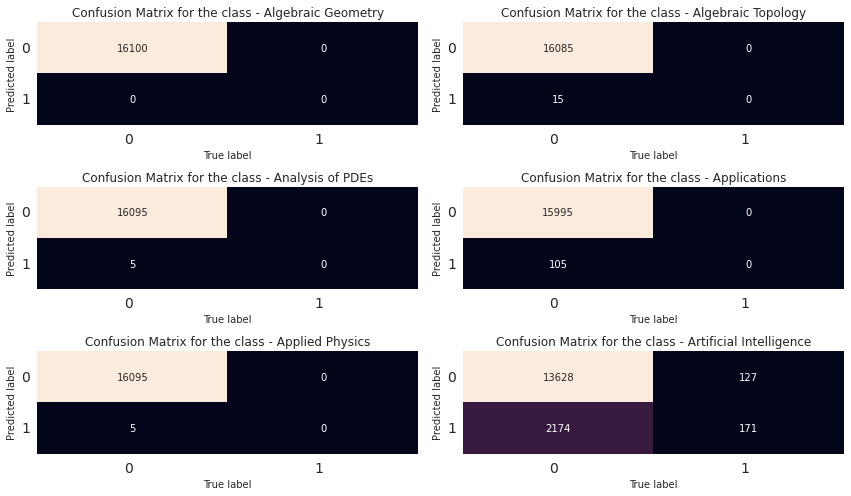

In [ ]:
#print_confusion_matrix(mcm(targets, val_preds),class_label=labels, class_names=labels)
sns.set_style("whitegrid")
fig, ax = plt.subplots(3, 2, figsize=(12, 7))
for axes, cfs_matrix, label in zip(ax.flatten(), cm, cm_labels):
  print_confusion_matrix(cfs_matrix, axes, label, ["0", "1"])
    
fig.tight_layout()
plt.show()

## Multi-label Performance Metrics

In [ ]:
from sklearn import metrics
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.metrics import hamming_loss
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score

In [ ]:
def average_precision_recall(Y_test, y_score, n_classes):
  # For each class
  precision = dict()
  recall = dict()
  average_precision = dict()
  average_recall = dict()
  for i in range(n_classes):
      precision[i], recall[i], _ = precision_recall_curve(Y_test[:, i],
                                                          y_score[:, i])
      average_precision[i] = average_precision_score(Y_test[:, i], y_score[:, i])

  # A "micro-average": quantifying score on all classes jointly
  precision["micro"], recall["micro"], _ = precision_recall_curve(Y_test.ravel(),
      y_score.ravel())
  average_precision["micro"] = average_precision_score(Y_test, y_score,
                                                      average="micro")
  average_recall["micro"] = recall_score(Y_test, y_score,
                                                      average="micro")
  print('Average precision score, micro-averaged over all classes: {0:0.2f}'
        .format(average_precision["micro"]))
  
  print('Average precision score, micro-averaged over all classes: {0:0.2f}'
        .format(average_recall["micro"]))

In [ ]:
global n_classes
n_classes = list(set(mlb.classes_))

In [ ]:
class MultiLabelClassificationMetrics:

  def __init__(self, true_values, pred_values):
    self.y_true = true_values
    self.y_pred = pred_values
    print("Hamming Loss:\t", round(hamming_loss(self.y_true, self.y_pred), 2))
    print("Precision Macro:\t", round(precision_score(self.y_true, self.y_pred, average='macro'), 2))
    print("Precision Sample:\t", round(precision_score(self.y_true, self.y_pred, average='samples'), 2))
    print("Precision Average:\t", precision_score(self.y_true, self.y_pred, average='weighted'), 2)

    print("Recall Macro:\t", round(recall_score(self.y_true, self.y_pred, average = "macro"), 2))
    print("Recall Sample:\t", round(recall_score(self.y_true, self.y_pred, average = "samples"), 2))
    print("Recall Average:\t", recall_score(self.y_true, self.y_pred, average = "weighted"), 2)

    print("F1 Score Macro:\t", round(f1_score(self.y_true, self.y_pred, average = "macro"), 2))
    print("F1 Score Micro:\t", round(f1_score(self.y_true, self.y_pred, average = "micro"), 2))
    print("F1 Score Average:\t", f1_score(self.y_true, self.y_pred, average = "weighted"), 2)

  # @staticmethod
  # def Hamming_Loss(y_true, y_pred):
  #   temp=0
  #   for i in range(y_true.shape[0]):
  #       temp += np.size(y_true[i] == y_pred[i]) - np.count_nonzero(y_true[i] == y_pred[i])
  #   return temp/(y_true.shape[0] * y_true.shape[1])

  # @staticmethod
  # def Precision(y_true, y_pred):
  #       i = set(y_true).intersection(y_pred)
  #       len1 = len(y_pred)
  #       if len1 == 0:
  #           return 0
  #       else:
  #           return len(i) / len1

  # @staticmethod
  # def Recall(y_true, y_pred):
  #   i = set(y_true).intersection(y_pred)
  #   return len(i) / len(y_true)

  # @staticmethod
  # def F1Measure(self, y_true, y_pred):

  #   p = self.Precision(y_true, y_pred)
  #   r = self.Recall(y_true, y_pred)
  #   if p + r == 0:
  #     return 0
  #   else:
  #     return 2 * (p * r) / (p + r)


## Doc2Vec

In [ ]:
mlb = MultiLabelBinarizer() 
#transform the genre_new column to a series of columns with binary values
binary_labels=pd.DataFrame(mlb.fit_transform(df['label']),columns=mlb.classes_) 

#order columns alphabetically
# binary_labels=binary_labels.sort_index(axis=1) 

binary_labels.tail()

,Algebraic Geometry,Algebraic Topology,Analysis of PDEs,Applications,Applied Physics,Artificial Intelligence,Atmospheric and Oceanic Physics,Biological Physics,Biomolecules,Category Theory,...,Rings and Algebras,Robotics,Social and Information Networks,Software Engineering,Sound,Spectral Theory,Statistics Theory,Symbolic Computation,Systems and Control,Tissues and Organs
45988,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
45989,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
45990,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
45991,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
45992,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df.head()

,index,titles,text,label,token_counts,Algebraic Geometry,Algebraic Topology,Analysis of PDEs,Applications,Applied Physics,...,Rings and Algebras,Robotics,Social and Information Networks,Software Engineering,Sound,Spectral Theory,Statistics Theory,Symbolic Computation,Systems and Control,Tissues and Organs
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Arti...",225,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Arti...",259,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df.shape, binary_labels.shape

((45993, 93), (45993, 88))

In [ ]:
df_ = df.merge(binary_labels, how='inner', left_index=True, right_index=True)

In [ ]:
import nltk
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
df_["text"] = df_["text"].str.lower().str.replace('[^a-z ]', '')

<ipython-input-39-9d4c449ada03>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df_["text"] = df_["text"].str.lower().str.replace('[^a-z ]', '')


In [ ]:
def remove_stopwords(text:str, stopwords):
  text_ = []
  for x in text.split(" "):
    if x not in stopwords:
      text_.append(x)

  return " ".join(text_)

In [ ]:
df_["text"] = df_["text"].apply(lambda x : remove_stopwords(x, stopwords))

In [ ]:
df_['label'] = df_['label'].apply(lambda x : ", ".join(x))

In [ ]:
from sklearn.metrics import balanced_accuracy_score

In [ ]:
xtrain, xval, ytrain, yval = train_test_split(df_['text'], binary_labels, test_size=0.2, random_state=9)

In [ ]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

In [ ]:
sents_train = []

for row in xtrain.tolist():
  sents_train.append(row.split())
  
sents_test = []

for row in xval.tolist():
  sents_test.append(row.split())

In [ ]:
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(sents_train)]

In [ ]:
model_d2v = Doc2Vec(documents, min_count=51, epochs=30)
model_d2v.train(documents, total_examples=model_d2v.corpus_count, epochs=model_d2v.epochs)

num_features = len(model_d2v.wv.vocab)

d2v_ebd_len = model_d2v.infer_vector(sents_train[0]).shape[0]
x_train_d2v = np.zeros([len(xtrain), d2v_ebd_len]) # initialize to zero, save zero padding
x_test_d2v = np.zeros([len(xval), d2v_ebd_len])

for i in range(len(sents_train)):
  sent = sents_train[i]
  x_train_d2v[i] = model_d2v.infer_vector(sent)

y_train_d2v = ytrain

for i in range(len(sents_test)):
  sent = sents_test[i]
  x_test_d2v[i] = model_d2v.infer_vector(sent)

y_test_d2v = yval


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import classification_report
from sklearn import metrics

# initialize binary relevance multi-label classifier
classifier = RandomForestClassifier(max_depth=10000, random_state=0)
# train
classifier.fit(x_train_d2v, y_train_d2v)
# predict
predictions = classifier.predict(x_test_d2v)



In [ ]:
from sklearn import metrics

print("Accuracy score for Random Forest:")
print(metrics.accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))

Accuracy score for Random Forest:
0.5589738015001631
Individual genre predictions:
                                                 precision    recall  f1-score   support

                             Algebraic Geometry       0.00      0.00      0.00         1
                             Algebraic Topology       0.00      0.00      0.00         4
                               Analysis of PDEs       0.00      0.00      0.00         2
                                   Applications       0.00      0.00      0.00        46
                                Applied Physics       1.00      0.25      0.40         4
                        Artificial Intelligence       0.99      0.11      0.20      1475
                Atmospheric and Oceanic Physics       0.00      0.00      0.00         4
                             Biological Physics       0.00      0.00      0.00         4
                                   Biomolecules       1.00      0.10      0.18        10
                          

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
MultiLabelClassificationMetrics(np.array(yval), np.array(predictions))

Hamming Loss:	 0.01
Precision Macro:	 0.27
Precision Sample:	 0.92
Precision Average:	 0.8691341226014307 2


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.05
Recall Sample:	 0.8
Recall Average:	 0.6943240598350342 2
F1 Score Macro:	 0.06
F1 Score Micro:	 0.78
F1 Score Average:	 0.6933246096631785 2


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [ ]:
predictions = model_rf_d2v.predict(x_test_d2v)

In [ ]:
MultiLabelClassificationMetrics(np.array(yval), np.array(predictions))

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

# split dataset into training and validation set
tfidf_vectorizer = TfidfVectorizer(max_df=0.8, max_features=10000)
xtrain, xval, ytrain, yval = train_test_split(df_['text'], binary_labels, test_size=0.2, random_state=9)

xtrain_tfidf = tfidf_vectorizer.fit_transform(xtrain).toarray()
xval_tfidf = tfidf_vectorizer.transform(xval).toarray()

## TF-IDF

In [ ]:
mlb = MultiLabelBinarizer() 
#transform the genre_new column to a series of columns with binary values
binary_labels=pd.DataFrame(mlb.fit_transform(df['label']),columns=mlb.classes_) 

#order columns alphabetically
# binary_labels=binary_labels.sort_index(axis=1) 

binary_labels.tail()

,Algebraic Geometry,Computation and Language,Computer Vision and Pattern Recognition,Databases,Machine Learning,Numerical Analysis,Other
45988,0,0,0,0,1,0,1
45989,0,0,1,0,0,0,1
45990,0,0,0,0,1,0,1
45991,0,0,1,0,0,0,0
45992,0,0,0,0,1,0,1


In [ ]:
df.head()

,index,titles,text,label,token_counts,Algebraic Geometry,Computation and Language,Computer Vision and Pattern Recognition,Databases,Machine Learning,Numerical Analysis,Other
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Othe...",225,0.0,0.0,1.0,0.0,1.0,0.0,1.0
2,2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Other]",259,0.0,0.0,1.0,0.0,0.0,0.0,1.0
3,3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291,0.0,0.0,1.0,0.0,1.0,0.0,0.0


In [ ]:
df.shape, binary_labels.shape

((45993, 93), (45993, 88))

In [ ]:
df_ = df.merge(binary_labels, how='inner', left_index=True, right_index=True)

In [ ]:
df_.head()

,index,titles,text,label,token_counts,Algebraic Geometry_x,Computation and Language_x,Computer Vision and Pattern Recognition_x,Databases_x,Machine Learning_x,Numerical Analysis_x,Other_x,Algebraic Geometry_y,Computation and Language_y,Computer Vision and Pattern Recognition_y,Databases_y,Machine Learning_y,Numerical Analysis_y,Other_y
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey on semantic stereo matching semantic de...,"[Computer Vision and Pattern Recognition, Mach...",141,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0,0,1,0,1,0,0
1,1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles and consensus rec...,"[Computer Vision and Pattern Recognition, Othe...",225,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0,0,1,0,1,0,1
2,2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency of hard regions f...,"[Computer Vision and Pattern Recognition, Other]",259,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0,0,1,0,0,0,1
3,3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy for semi supervi...,[Computer Vision and Pattern Recognition],218,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0,0,1,0,0,0,0
4,4,Background-Foreground Segmentation for Interio...,background foreground segmentation for interio...,"[Computer Vision and Pattern Recognition, Mach...",291,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0,0,1,0,1,0,0


In [ ]:
df_.shape

(45993, 181)

In [ ]:
import nltk
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
df_["text"] = df_["text"].str.lower().str.replace('[^a-z ]', '')

<ipython-input-41-9d4c449ada03>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df_["text"] = df_["text"].str.lower().str.replace('[^a-z ]', '')


In [ ]:
def remove_stopwords(text:str, stopwords):
  text_ = []
  for x in text.split(" "):
    if x not in stopwords:
      text_.append(x)

  return " ".join(text_)

In [ ]:
df_["text"] = df_["text"].apply(lambda x : remove_stopwords(x, stopwords))

In [ ]:
df_.head()

,index,titles,text,label,token_counts,Algebraic Geometry_x,Algebraic Topology_x,Analysis of PDEs_x,Applications_x,Applied Physics_x,...,Rings and Algebras_y,Robotics_y,Social and Information Networks_y,Software Engineering_y,Sound_y,Spectral Theory_y,Statistics Theory_y,Symbolic Computation_y,Systems and Control_y,Tissues and Organs_y
0,0,Survey on Semantic Stereo Matching / Semantic ...,survey semantic stereo matching semantic depth...,"[Computer Vision and Pattern Recognition, Mach...",141,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1,1,FUTURE-AI: Guiding Principles and Consensus Re...,future ai guiding principles consensus recomme...,"[Computer Vision and Pattern Recognition, Arti...",225,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
2,2,Enforcing Mutual Consistency of Hard Regions f...,enforcing mutual consistency hard regions semi...,"[Computer Vision and Pattern Recognition, Arti...",259,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
3,3,Parameter Decoupling Strategy for Semi-supervi...,parameter decoupling strategy semi supervised ...,[Computer Vision and Pattern Recognition],218,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
4,4,Background-Foreground Segmentation for Interio...,background foreground segmentation interior se...,"[Computer Vision and Pattern Recognition, Mach...",291,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_['label'] = df_['label'].apply(lambda x : ", ".join(x))

In [ ]:
from sklearn.metrics import balanced_accuracy_score

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

# split dataset into training and validation set
tfidf_vectorizer = TfidfVectorizer(max_df=0.8, max_features=10000)
xtrain, xval, ytrain, yval = train_test_split(df_['text'], binary_labels, test_size=0.2, random_state=9)

xtrain_tfidf = tfidf_vectorizer.fit_transform(xtrain).toarray()
xval_tfidf = tfidf_vectorizer.transform(xval).toarray()

In [ ]:
xval

17111    multi head attention collaborate instead conca...
1418     discriminative generative representation learn...
29479    black box optimizer implicit natural gradientb...
38772    look investigate classify deep hybrid attentio...
1199     unsupervised dynamic image segmentation using ...
                               ...                        
13963    truly generalizable radiograph segmentation co...
26009    gspn generative shape proposal network instanc...
15462    data free network quantization adversarial kno...
16426    curve structure segmentation depth maps cnn ba...
29499    sample efficiency sparse reinforcement learnin...
Name: text, Length: 9199, dtype: object

In [ ]:
xtrain

43136    learning stochastic decision treeswe give quas...
10088    offroadtranseg semi supervised segmentation us...
29082    selective pseudo labeling reinforcement learni...
42965    learning unsupervised visual grounding semanti...
31529    variational inverse control events general fra...
                               ...                        
5014     groomed nms grouped mathematically differentia...
42747    teaching ai explain decisions using embeddings...
22584    polarization human shape pose datasetpolarizat...
501      votenet deep learning label fusion method mult...
20828    learning segment point clouds image spacein co...
Name: text, Length: 36794, dtype: object

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import accuracy_score

#Run Logistic Regrssion
logreg = LogisticRegression()
logreg_classifier = OneVsRestClassifier(logreg)

# fit model on train data
logreg_classifier.fit(xtrain_tfidf, ytrain)

# make predictions for validation set
predictions = logreg_classifier.predict(xval_tfidf)

# evaluate performance
print("Accuracy score for Logistic Regression:")
print(accuracy_score(yval, predictions))

/usr/local/lib/python3.8/dist-packages/sklearn/multiclass.py:79: UserWarning: Label not 0 is present in all training examples.
  warnings.warn(


KeyboardInterrupt: ignored

In [ ]:
import warnings
warnings.filterwarnings('always')

In [ ]:
from sklearn.metrics import classification_report
#Show precision and recall per genre
print(classification_report(yval, predictions, target_names=binary_labels.columns))

                                                 precision    recall  f1-score   support

                             Algebraic Geometry       0.00      0.00      0.00         1
                             Algebraic Topology       0.00      0.00      0.00         4
                               Analysis of PDEs       0.00      0.00      0.00         2
                                   Applications       0.00      0.00      0.00        46
                                Applied Physics       0.00      0.00      0.00         4
                        Artificial Intelligence       0.65      0.11      0.19      1475
                Atmospheric and Oceanic Physics       0.00      0.00      0.00         4
                             Biological Physics       0.00      0.00      0.00         4
                                   Biomolecules       0.00      0.00      0.00        10
                                Category Theory       0.00      0.00      0.00         0
                    

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1

In [ ]:
MultiLabelClassificationMetrics(np.array(yval), np.array(predictions))

Hamming Loss:	 0.01
Precision Macro:	 0.09


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Sample:	 0.95
Precision Average:	 0.82


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.03
Recall Sample:	 0.77


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


Recall Average:	 0.66
F1 Score Macro:	 0.03
F1 Score Micro:	 0.78
F1 Score Average:	 0.7


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [ ]:
!pip install scikit-multilearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from skmultilearn.problem_transform import BinaryRelevance
from sklearn.naive_bayes import GaussianNB


# initialize binary relevance multi-label classifier
# with a gaussian naive bayes base classifier
classifier = BinaryRelevance(GaussianNB())
# train
classifier.fit(xtrain_tfidf, ytrain)
# predict
predictions = classifier.predict(xval_tfidf)

print("Accuracy score for Gaussian Naive Bayes:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))

Accuracy score for Gaussian Naive Bayes:
0.2676377867159474
Individual genre predictions:
                                                 precision    recall  f1-score   support

                             Algebraic Geometry       0.00      0.00      0.00         1
                             Algebraic Topology       1.00      0.50      0.67         4
                               Analysis of PDEs       1.00      0.50      0.67         2
                                   Applications       0.76      0.35      0.48        46
                                Applied Physics       1.00      0.25      0.40         4
                        Artificial Intelligence       0.21      0.87      0.34      1475
                Atmospheric and Oceanic Physics       1.00      0.25      0.40         4
                             Biological Physics       1.00      0.50      0.67         4
                                   Biomolecules       1.00      0.50      0.67        10
                   

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1

TypeError: ignored

In [ ]:
from scipy.sparse import csr_matrix

In [ ]:
MultiLabelClassificationMetrics(yval, csr_matrix(predictions).toarray() )

Hamming Loss:	 0.02


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Macro:	 0.6


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Sample:	 0.6


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Average:	 0.78


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.29
Recall Sample:	 0.74


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Average:	 0.69


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


F1 Score Macro:	 0.35
F1 Score Micro:	 0.61
F1 Score Average:	 0.69


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import classification_report

# initialize binary relevance multi-label classifier
classifier = RandomForestClassifier(max_depth=10000, random_state=0)
# train
classifier.fit(xtrain_tfidf, ytrain)
# predict
predictions = classifier.predict(xval_tfidf)

print("Accuracy score for Random Forest:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))

In [ ]:
print("Accuracy score for Random Forest:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))

Accuracy score for Random Forest:
0.7352973149255354
Individual genre predictions:
                                         precision    recall  f1-score   support

                     Algebraic Geometry       0.00      0.00      0.00         1
               Computation and Language       1.00      0.49      0.66       290
Computer Vision and Pattern Recognition       0.95      0.96      0.95      5317
                              Databases       1.00      0.11      0.20        18
                       Machine Learning       0.95      0.90      0.93      5141
                     Numerical Analysis       1.00      0.39      0.56        18
                                  Other       0.86      0.50      0.63      2841

                              micro avg       0.94      0.83      0.88     13626
                              macro avg       0.82      0.48      0.56     13626
                           weighted avg       0.93      0.83      0.87     13626
                        

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import classification_report

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))

Individual genre predictions:
                                         precision    recall  f1-score   support

                     Algebraic Geometry       0.00      0.00      0.00         1
               Computation and Language       1.00      0.49      0.66       290
Computer Vision and Pattern Recognition       0.95      0.96      0.95      5317
                              Databases       1.00      0.11      0.20        18
                       Machine Learning       0.95      0.90      0.93      5141
                     Numerical Analysis       1.00      0.39      0.56        18
                                  Other       0.86      0.50      0.63      2841

                              micro avg       0.94      0.83      0.88     13626
                              macro avg       0.82      0.48      0.56     13626
                           weighted avg       0.93      0.83      0.87     13626
                            samples avg       0.95      0.88      0.90     13

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
MultiLabelClassificationMetrics(np.array(yval), np.array(predictions))

Hamming Loss:	 0.0
Precision Macro:	 0.71
Precision Sample:	 0.96
Precision Average:	 0.96


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.28
Recall Sample:	 0.85
Recall Average:	 0.78
F1 Score Macro:	 0.38
F1 Score Micro:	 0.86
F1 Score Average:	 0.83


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


<h2> Using interpretability </h2>

In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import shap

# print the JS visualization code to the notebook
shap.initjs()

/usr/local/lib/python3.8/dist-packages/debugpy/_vendored/pydevd/_pydevd_bundle/pydevd_comm.py:596: ResourceWarning: unclosed file <_io.BufferedReader name='/usr/local/lib/python3.8/dist-packages/cv2/cv2.abi3.so'>
  frame = None


In [ ]:
def make_predictions(X_batch_text):
    X_batch = tfidf_vectorizer.transform(X_batch_text).toarray()
    preds = classifier.predict(X_batch)
    return preds

masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(make_predictions, masker=masker, output_names=mlb.classes_)

In [ ]:
explainer = shap.KernelExplainer(classifier.predict, xval_tfidf[0:10])

In [ ]:
shap_values = explainer.shap_values(xval_tfidf[0:10])

  0%|          | 0/10 [00:00<?, ?it/s]

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
The default of 'normalize' will be set to False in versi

In [ ]:
X_batch_text = xval[0:2]

In [ ]:
X_batch = xval_tfidf[0:10]

In [ ]:
d = list(tfidf_vectorizer.vocabulary_.keys())

In [ ]:
feature_n = list(tfidf_vectorizer.get_feature_names_out())

In [ ]:
class_names1 = ['Machine Learning', 'Computer Vision and Pattern Recognition', 'Databases', 'Computation and Language', 'Algebraic Geometry', 'Numerical Analysis', 'Other']

In [ ]:
class_names1

['Machine Learning',
 'Computer Vision and Pattern Recognition',
 'Computation and Language',
 'Algebraic Geometry',
 'Numerical Analysis']

In [ ]:
xval.iloc[1418]

'hyperrealistic image inpainting hypergraphsimage inpainting non trivial task computer vision due multiple possibilities filling missing data may dependent global information image existing approaches use attention mechanism learn global context image attention mechanism produces semantically plausible blurry results incapability capture global context paper introduce hypergraph convolution spatial features learn complex relationship among data introduce trainable mechanism connect nodes using hyperedges hypergraph convolution best knowledge hypergraph convolution never used spatial features image image tasks computer vision introduce gated convolution discriminator enforce local consistency predicted image experiments places celeba hq paris street view facades datasets show approach achieves state art results'

In [ ]:
print(shap.__version__)

0.41.0


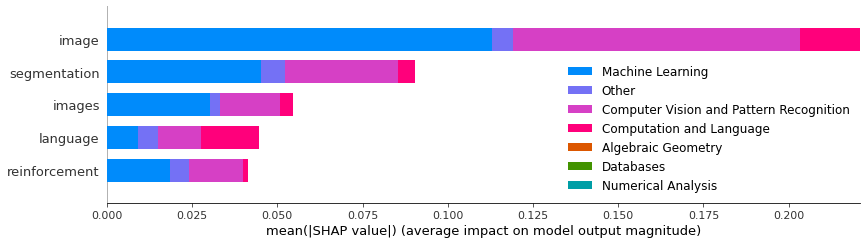

In [ ]:
import matplotlib.pyplot as plt

fig = plt.figure()
shap.summary_plot(shap_values, X_batch, feature_names=feature_n, class_names=mlb.classes_, max_display=5, show = False)
#plt.gcf().set_size_inches(8,4.4)
plt.tight_layout()


plt.subplots_adjust(right=1.5)
plt.show()


In [ ]:
shap_values

.values =
array([array([[0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.],
              ...,
              [0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.]]),
       array([[0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.],
              ...,
              [0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.],
              [0., 0., 0., ..., 0., 0., 0.]])], dtype=object)

.base_values =
array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0

In [ ]:
shap_values = explainer(X_batch_text)

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check th

  0%|          | 0/498 [00:00<?, ?it/s]

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To

  0%|          | 0/498 [00:00<?, ?it/s]

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To

In [ ]:
X_batch = xval_tfidf[0:1]
preds_proba = classifier.predict(X_batch)
preds = preds_proba.argmax(axis=1)

In [ ]:
preds

array([18, 24])

In [ ]:
explainer = shap.TreeExplainer(classifier)
shap_values = explainer.shap_values(X_batch)

shap.summary_plot(shap_values, X_batch)

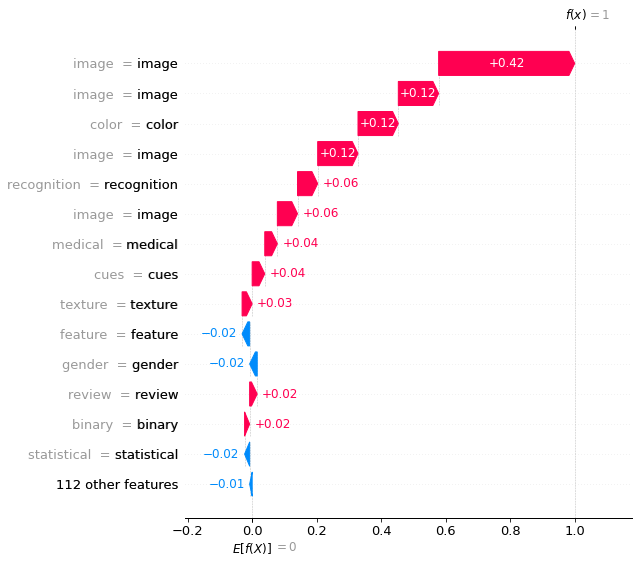

In [ ]:
shap.waterfall_plot(shap_values[1][:, mlb.classes_[preds[1]]], max_display=15)

In [ ]:
import xgboost as xgb
from sklearn.multioutput import MultiOutputClassifier

# initialize binary relevance multi-label classifier
classifier = xgb.XGBClassifier(objective='binary:logistic')
multilabel_model = MultiOutputClassifier(classifier)
# train
multilabel_model.fit(xtrain_tfidf, ytrain)
# predict
predictions = multilabel_model.predict(xval_tfidf)

print("Accuracy score for Random Forest:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))


Accuracy score for Random Forest:
0.5475595173388412
Individual genre predictions:
                                                 precision    recall  f1-score   support

                             Algebraic Geometry       0.00      0.00      0.00         1
                             Algebraic Topology       1.00      0.75      0.86         4
                               Analysis of PDEs       1.00      0.50      0.67         2
                                   Applications       1.00      0.09      0.16        46
                                Applied Physics       1.00      0.25      0.40         4
                        Artificial Intelligence       0.64      0.12      0.20      1475
                Atmospheric and Oceanic Physics       1.00      0.25      0.40         4
                             Biological Physics       1.00      0.25      0.40         4
                                   Biomolecules       0.71      0.50      0.59        10
                          

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1

In [ ]:
MultiLabelClassificationMetrics(np.array(yval), np.array(predictions))

Hamming Loss:	 0.01
Precision Macro:	 0.56


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Sample:	 0.92
Precision Average:	 0.84


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.17
Recall Sample:	 0.78
Recall Average:	 

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


0.68
F1 Score Macro:	 0.24
F1 Score Micro:	 0.77
F1 Score Average:	 0.71


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


## WORD2VEC

In [ ]:
import gensim
from gensim.models import Word2Vec, KeyedVectors, TfidfModel
import gensim.downloader as api
word2vec_model = api.load("glove-wiki-gigaword-200")
# word2vec_model = KeyedVectors.load_word2vec_format("glove-wiki-gigaword-200.gz")

can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.10 it will stop working
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
`scipy.sparse.sparsetools` is deprecated!
scipy.sparse.sparsetools is a private module for scipy.sparse, and should not be used.
can't

[==================================================] 100.0% 252.1/252.1MB downloaded


This function is deprecated.  See https://github.com/RaRe-Technologies/smart_open/blob/develop/MIGRATING_FROM_OLDER_VERSIONS.rst for more information


In [ ]:
def simple_average(sent):
    sents_emd = []
    for s in sent:
        sent_emd = []
        for w in s:
            if w in word2vec_model:
                sent_emd.append(word2vec_model[w])
        sent_emd_ar = np.array(sent_emd)
        sum_ = sent_emd_ar.sum(axis=0)
        result = sum_/np.sqrt((sum_**2).sum())
        sents_emd.append(result)
    return sents_emd

In [ ]:
training_sentences = xtrain.tolist()
testing_sentences = xval.tolist()

In [ ]:
training_sentences_w2v = simple_average(training_sentences)

In [ ]:
testing_sentences_w2v = simple_average(testing_sentences)

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import accuracy_score

#Run Logistic Regrssion
logreg = LogisticRegression()
logreg_classifier = OneVsRestClassifier(logreg)

# fit model on train data
logreg_classifier.fit(training_sentences_w2v, ytrain)

# make predictions for validation set
predictions = logreg_classifier.predict(testing_sentences_w2v)

# evaluate performance
print("Accuracy score for Logistic Regression:")
print(accuracy_score(yval, predictions))

/usr/local/lib/python3.7/dist-packages/sklearn/multiclass.py:80: UserWarning: Label not 0 is present in all training examples.
  "Label %s is present in all training examples." % str(classes[c])


Accuracy score for Logistic Regression:
0.348298728122622


In [ ]:
MultiLabelClassificationMetrics(np.array(yval), np.array(predictions))

Hamming Loss:	 0.01
Precision Macro:	 0.02


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Sample:	 0.6
Precision Average:	 0.58


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.01
Recall Sample:	 0.46


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


Recall Average:	 0.39
F1 Score Macro:	 0.01
F1 Score Micro:	 0.52
F1 Score Average:	 0.46


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [ ]:
from skmultilearn.problem_transform import BinaryRelevance
from sklearn.naive_bayes import GaussianNB


# initialize binary relevance multi-label classifier
# with a gaussian naive bayes base classifier
classifier = BinaryRelevance(GaussianNB())
# train
classifier.fit(training_sentences_w2v, ytrain)
# predict
predictions = classifier.predict(testing_sentences_w2v)

print("Accuracy score for Gaussian Naive Bayes:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))

Accuracy score for Gaussian Naive Bayes:
0.0038047613871072944
Individual genre predictions:
                                                 precision    recall  f1-score   support

                             Algebraic Geometry       0.00      0.00      0.00         1
                             Algebraic Topology       0.00      1.00      0.01         4
                               Analysis of PDEs       0.00      0.50      0.01         2
                                   Applications       0.01      0.43      0.02        46
                                Applied Physics       0.00      0.25      0.00         4
                        Artificial Intelligence       0.22      0.49      0.30      1475
                Atmospheric and Oceanic Physics       0.00      0.25      0.01         4
                             Biological Physics       0.02      0.50      0.04         4
                                   Biomolecules       0.00      0.30      0.00        10
                

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1

In [ ]:
MultiLabelClassificationMetrics(yval, csr_matrix(predictions).toarray() )

Hamming Loss:	 0.12


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Macro:	 0.03
Precision Sample:	 0.13


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Average:	 0.56


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Macro:	 0.39
Recall Sample:	 0.67


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Average:	 0.64


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


F1 Score Macro:	 0.04
F1 Score Micro:	 0.16
F1 Score Average:	 0.56


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification


# initialize binary relevance multi-label classifier
classifier = RandomForestClassifier(max_depth=10000, random_state=0)
# train
classifier.fit(training_sentences_w2v, ytrain)
# predict
predictions = classifier.predict(testing_sentences_w2v)

print("Accuracy score for Random Forest:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))
MultiLabelClassificationMetrics(yval, csr_matrix(predictions).toarray() )

Accuracy score for Random Forest:
0.6081095771279487
Individual genre predictions:
                                         precision    recall  f1-score   support

                     Algebraic Geometry       0.00      0.00      0.00         1
               Computation and Language       1.00      0.49      0.66       290
Computer Vision and Pattern Recognition       0.82      0.88      0.85      5317
                              Databases       1.00      0.11      0.20        18
                       Machine Learning       0.81      0.87      0.84      5141
                     Numerical Analysis       1.00      0.39      0.56        18
                                  Other       0.93      0.38      0.54      2841

                              micro avg       0.83      0.76      0.79     13626
                              macro avg       0.79      0.45      0.52     13626
                           weighted avg       0.84      0.76      0.78     13626
                        

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


NameError: ignored

In [ ]:
MultiLabelClassificationMetrics(yval, csr_matrix(predictions).toarray() )

Hamming Loss:	 0.01
Precision Macro:	 0.71
Precision Sample:	 0.84


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Average:	 0.86
Recall Macro:	 0.28
Recall Sample:	 0.79


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Average:	 0.73
F1 Score Macro:	 0.38
F1 Score Micro:	 0.78
F1 Score Average:	 0.75


/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


<h2> Interpretability </h2>

In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 575.9/575.9 KB 11.8 MB/s eta 0:00:00


In [ ]:
import shap

# print the JS visualization code to the notebook
shap.initjs()

In [ ]:
testing_sentences_w2v = np.array(testing_sentences_w2v)

In [ ]:
explainer = shap.KernelExplainer(classifier.predict, testing_sentences_w2v[0:10])

In [ ]:
shap_values = explainer.shap_values(testing_sentences_w2v[0:10])

  0%|          | 0/10 [00:00<?, ?it/s]

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
The default of 'normalize' will be set to False in versi

In [ ]:
X_batch = testing_sentences_w2v[0:10]

In [ ]:
feature_n = list(word2vec_model.wv.vocab.keys())

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).


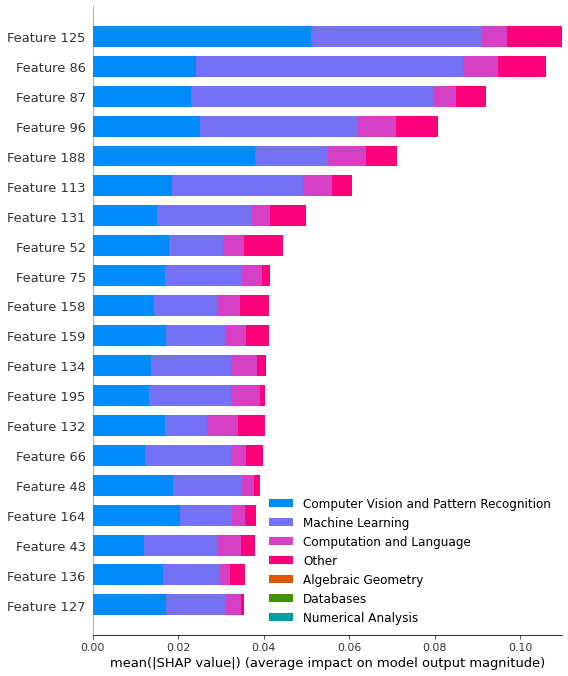

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

shap.summary_plot(shap_values, X_batch,  class_names=mlb.classes_)
plt.tight_layout()

In [ ]:
def make_predictions_word2vec(X_batch_text):
    X_batch = simple_average(X_batch_text.tolist())
    preds = classifier.predict(X_batch)
    return preds

masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(make_predictions_word2vec, masker=masker, output_names=mlb.classes_)

In [ ]:
X_batch_text = xval[1:3]
for text in X_batch_text:
    print(re.split(r"\W+", text))
    print()

['discriminative', 'generative', 'representation', 'learning', 'one', 'class', 'anomaly', 'detectionas', 'kind', 'generative', 'self', 'supervised', 'learning', 'methods', 'generative', 'adversarial', 'nets', 'widely', 'studied', 'field', 'anomaly', 'detection', 'however', 'representation', 'learning', 'ability', 'generator', 'limited', 'since', 'pays', 'much', 'attention', 'pixel', 'level', 'details', 'generator', 'difficult', 'learn', 'abstract', 'semantic', 'representations', 'label', 'prediction', 'pretext', 'tasks', 'effective', 'discriminator', 'order', 'improve', 'representation', 'learning', 'ability', 'generator', 'propose', 'self', 'supervised', 'learning', 'framework', 'combining', 'generative', 'methods', 'discriminative', 'methods', 'generator', 'longer', 'learns', 'representation', 'reconstruction', 'error', 'guidance', 'discriminator', 'could', 'benefit', 'pretext', 'tasks', 'designed', 'discriminative', 'methods', 'discriminative', 'generative', 'representation', 'learn

In [ ]:
shap_values = explainer(X_batch_text)

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 1/2 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 3it [00:20, 10.48s/it]


In [ ]:
X_batch = simple_average(xval[1:3].tolist())
preds_proba = classifier.predict(X_batch)
preds = preds_proba.argmax(axis=1)

In [ ]:
shap.text_plot(shap_values[0])

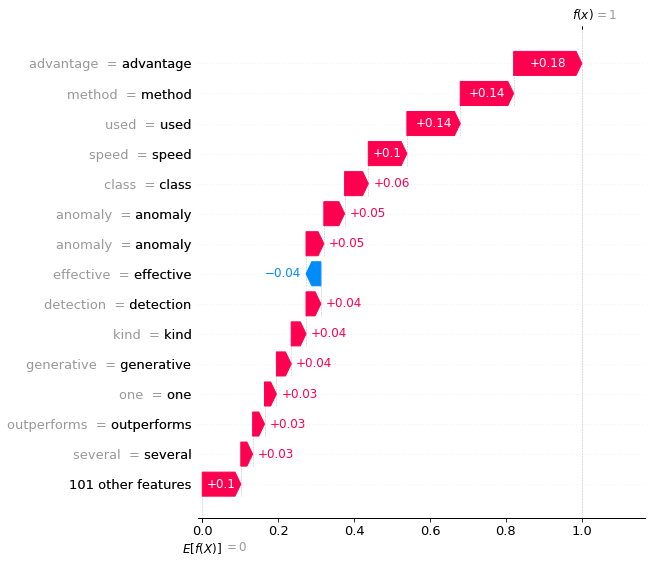

In [ ]:
shap.waterfall_plot(shap_values[0][:, mlb.classes_[preds[0]]], max_display=15)

In [ ]:
import xgboost as xgb
from sklearn.multioutput import MultiOutputClassifier

# initialize binary relevance multi-label classifier
classifier = xgb.XGBClassifier(objective='binary:logistic')
multilabel_model = MultiOutputClassifier(classifier)
# train
multilabel_model.fit(np.array(training_sentences_w2v), ytrain)
# predict
predictions = multilabel_model.predict(np.array(testing_sentences_w2v))

print("Accuracy score for Random Forest:")
print(accuracy_score(yval, predictions))

print("Individual genre predictions:")
print(classification_report(yval, predictions, target_names=binary_labels.columns))
MultiLabelClassificationMetrics(yval, csr_matrix(predictions).toarray() )


Accuracy score for Random Forest:
0.40819654310251113
Individual genre predictions:
                                                 precision    recall  f1-score   support

                             Algebraic Geometry       0.00      0.00      0.00         1
                             Algebraic Topology       1.00      0.50      0.67         4
                               Analysis of PDEs       1.00      0.50      0.67         2
                                   Applications       0.00      0.00      0.00        46
                                Applied Physics       1.00      0.25      0.40         4
                        Artificial Intelligence       0.67      0.00      0.00      1475
                Atmospheric and Oceanic Physics       1.00      0.25      0.40         4
                             Biological Physics       1.00      0.25      0.40         4
                                   Biomolecules       1.00      0.20      0.33        10
                         

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1

Hamming Loss:	 0.01
Precision Macro:	 0.38
Precision Sample:	 0.77


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision Average:	 0.68
Recall Macro:	 0.11


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Recall Sample:	 0.68
Recall Average:	 0.58
F1 Score Macro:	 0.15


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))


F1 Score Micro:	 0.65
F1 Score Average:	 0.57


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
